<a href="https://colab.research.google.com/github/RyanXJu/Airbnb_Montreal/blob/master/Airbnb_Montreal.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/gdrive


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

import seaborn as sns
import scipy

# reviews data

In [ ]:
# load datasets
root_path = 'gdrive/My Drive/Airbnb/'
review_detail = pd.read_csv(root_path+"reviews_detail.csv")
review_summary = pd.read_csv(root_path + "reviews_summary.csv")

In [ ]:
print(review_detail.shape)
review_detail.head()

(475222, 6)


,listing_id,id,date,reviewer_id,reviewer_name,comments
0,2078,507650,2011-09-06,992890,Bryce,Very comfortable room in Montreal's best neigh...
1,2078,603624,2011-10-06,910800,Nicole,Nelia was friendly and very accomidating. The ...
2,2078,626772,2011-10-13,1202298,Jean-Louis,"Nelia is friendly, thrustable and respectful o..."
3,2078,673852,2011-10-29,1301287,Nadjet,I really enjoyed my stay at Nelia’s home. I fe...
4,2078,683905,2011-11-01,1325732,Claudette,We had a fabulous time in Montréal and staying...


In [ ]:
print(review_summary.shape)
review_summary.head()

(475222, 2)


,listing_id,date
0,2078,2011-09-06
1,2078,2011-10-06
2,2078,2011-10-13
3,2078,2011-10-29
4,2078,2011-11-01


# listing data

In [ ]:
# load listing datasets
root_path = 'gdrive/My Drive/Airbnb/'
listings_detail = pd.read_csv(root_path+"listings_detail.csv")
listings_summary = pd.read_csv(root_path + "listings_summary.csv")

/usr/local/lib/python3.6/dist-packages/IPython/core/interactiveshell.py:2718: DtypeWarning: Columns (61,62) have mixed types. Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


In [ ]:
print(listings_detail.shape)
listings_detail.head(3)

(20466, 106)


,id,listing_url,scrape_id,last_scraped,name,summary,space,description,experiences_offered,neighborhood_overview,notes,transit,access,interaction,house_rules,thumbnail_url,medium_url,picture_url,xl_picture_url,host_id,host_url,host_name,host_since,host_location,host_about,host_response_time,host_response_rate,host_acceptance_rate,host_is_superhost,host_thumbnail_url,host_picture_url,host_neighbourhood,host_listings_count,host_total_listings_count,host_verifications,host_has_profile_pic,host_identity_verified,street,neighbourhood,neighbourhood_cleansed,...,extra_people,minimum_nights,maximum_nights,minimum_minimum_nights,maximum_minimum_nights,minimum_maximum_nights,maximum_maximum_nights,minimum_nights_avg_ntm,maximum_nights_avg_ntm,calendar_updated,has_availability,availability_30,availability_60,availability_90,availability_365,calendar_last_scraped,number_of_reviews,number_of_reviews_ltm,first_review,last_review,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,requires_license,license,jurisdiction_names,instant_bookable,is_business_travel_ready,cancellation_policy,require_guest_profile_picture,require_guest_phone_verification,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month
0,2078,https://www.airbnb.com/rooms/2078,20200113202958,2020-01-14,Central comfy close to Metro Laurie,Centrally located in trendy Le Plateau. Join...,Centrally located clean comfy furnished room ...,Centrally located in trendy Le Plateau. Join...,none,Although my place is centrally located in Le P...,I always inform my guests the places/attractio...,I am 6-8 mins. walk to Metro Laurie and bus ro...,You will have full access in the apartment. I...,I am always available to help and give informa...,No house rules but I expect my guests to follo...,NaN,NaN,https://a0.muscache.com/im/pictures/88170231/0...,NaN,2277,https://www.airbnb.com/users/show/2277,Nelia,2008-08-19,"Montreal, Québec, Canada","Honest, quiet and adhere to the golden rules a...",within a few hours,100%,NaN,f,https://a0.muscache.com/im/users/2277/profile_...,https://a0.muscache.com/im/users/2277/profile_...,Le Plateau,1.0,1.0,"['email', 'phone', 'reviews', 'manual_offline'...",t,t,"Montreal, QC, Canada",Le Plateau-Mont-Royal,Le Plateau-Mont-Royal,...,$6.00,2,7,2,2,7,7,2.0,7.0,7 weeks ago,t,0,0,0,226,2020-01-14,245,0,2011-09-06,2018-09-23,93.0,10.0,9.0,10.0,10.0,10.0,10.0,f,NaN,"{Quebec,"" CA""}",t,f,flexible,f,f,1,0,1,0,2.41
1,2843,https://www.airbnb.com/rooms/2843,20200113202958,2020-01-14,Fabulous downtown/airport room,Come stay in this trendy area of downtown Mont...,"Private individual room in the downtown area, ...",Come stay in this trendy area of downtown Mont...,none,This area of St Henri is actually downtown Mon...,From this room you can walk to downtown Montre...,There is a major metro/subway stop called Lion...,"The guests can use the kitchen anytime, fully ...",I meet guests when they arrive show them the h...,No smoking and no pets Airport bus stops acros...,NaN,NaN,https://a0.muscache.com/im/pictures/803776/a2a...,NaN,2319,https://www.airbnb.com/users/show/2319,Gail,2008-08-19,"Montreal, Québec, Canada",Manage a network of downtown rooms and private...,within an hour,100%,NaN,f,https://a0.muscache.com/im/pictures/user/7c04e...,https://a0.muscache.com/im/pictures/user/7c04e...,Little Burgundy,6.0,6.0,"['email', 'phone', 'facebook', 'reviews', 'jum...",t,t,"Montréal, Québec, Canada",Le Sud-Ouest,Le Sud-Ouest,...,$10.00,1,365,1,1,365,365,1.0,365.0,3 days ago,t,18,18,18,18,2020-01-14,143,30,2009-06-20,2019-12-30,88.0,9.0,9.0,9.0,9.0,10.0,10.0,f,NaN,"{Quebec,"" CA""}",t,f,moderate,f,f,5,2,3,0,1.11
2,14584,https://www.airbnb.com/rooms/14584,20200113202958,2020-01-14,"Spread Out in 1,200 Square Feet of Luxury in t...",This stylish and spaciou

In [ ]:
print(listings_summary.shape)
listings_summary.head()

(20466, 16)


,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
0,2078,Central comfy close to Metro Laurie,2277,Nelia,NaN,Le Plateau-Mont-Royal,45.53069,-73.58588,Private room,39,2,245,2018-09-23,2.41,1,226
1,2843,Fabulous downtown/airport room,2319,Gail,NaN,Le Sud-Ouest,45.48442,-73.57923,Private room,30,1,143,2019-12-30,1.11,5,18
2,14584,"Spread Out in 1,200 Square Feet of Luxury in t...",57358,Verona,NaN,Le Plateau-Mont-Royal,45.54135,-73.57814,Entire home/apt,175,3,171,2019-11-29,1.63,1,363
3,29059,Lovely studio Quartier Latin,125031,Maryline,NaN,Ville-Marie,45.51888,-73.56546,Entire home/apt,81,2,319,2020-01-03,2.74,2,318
4,29061,Maison historique - Quartier Latin,125031,Maryline,NaN,Ville-Marie,45.52020,-73.56422,Entire home/apt,145,3,65,2020-01-01,0.68,2,344


# neighbourhoods

In [ ]:
# load neighbourhoods datasets
neighbourhoods = pd.read_csv(root_path+"neighbourhoods.csv")
print(neighbourhoods.shape)
neighbourhoods.head()

(34, 2)


,neighbourhood_group,neighbourhood
0,NaN,Ahuntsic-Cartierville
1,NaN,Anjou
2,NaN,Baie-d'Urfé
3,NaN,Beaconsfield
4,NaN,Côte-des-Neiges-Notre-Dame-de-Grâce


# calendar

In [ ]:
# load neighbourhoods datasets
calendar = pd.read_csv(root_path+"calendar.csv")
print(calendar.shape)
calendar.head(10)

(7470195, 7)


,listing_id,date,available,price,adjusted_price,minimum_nights,maximum_nights
0,364710,2020-01-14,t,$150.00,$150.00,90.0,1125.0
1,41149629,2020-01-14,f,$140.00,$140.00,30.0,1125.0
2,41149629,2020-01-15,f,$140.00,$140.00,30.0,1125.0
3,41149629,2020-01-16,f,$140.00,$140.00,30.0,1125.0
4,41149629,2020-01-17,f,$140.00,$140.00,30.0,1125.0
5,41149629,2020-01-18,f,$140.00,$140.00,30.0,1125.0
6,41149629,2020-01-19,f,$140.00,$140.00,30.0,1125.0
7,41149629,2020-01-20,f,$140.00,$140.00,30.0,1125.0
8,41149629,2020-01-21,f,$140.00,$140.00,30.0,1125.0
9,41149629,2020-01-22,f,$140.00,$140.00,30.0,1125.0


# Visulization
#### all the informations in other csv files can be found in listing_detail

In [ ]:
# use listings_summary to do some basic graphs
df = listings_summary
df.head()


,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
0,2078,Central comfy close to Metro Laurie,2277,Nelia,NaN,Le Plateau-Mont-Royal,45.53069,-73.58588,Private room,39,2,245,2018-09-23,2.41,1,226
1,2843,Fabulous downtown/airport room,2319,Gail,NaN,Le Sud-Ouest,45.48442,-73.57923,Private room,30,1,143,2019-12-30,1.11,5,18
2,14584,"Spread Out in 1,200 Square Feet of Luxury in t...",57358,Verona,NaN,Le Plateau-Mont-Royal,45.54135,-73.57814,Entire home/apt,175,3,171,2019-11-29,1.63,1,363
3,29059,Lovely studio Quartier Latin,125031,Maryline,NaN,Ville-Marie,45.51888,-73.56546,Entire home/apt,81,2,319,2020-01-03,2.74,2,318
4,29061,Maison historique - Quartier Latin,125031,Maryline,NaN,Ville-Marie,45.52020,-73.56422,Entire home/apt,145,3,65,2020-01-01,0.68,2,344


(array(['Entire home/apt', 'Hotel room', 'Private room', 'Shared room'],
      dtype=object), array([14508,    66,  5708,   184]))


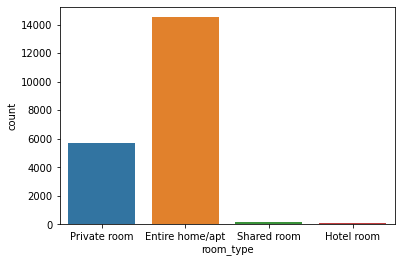

In [ ]:
# distribution
# room types
print(np.unique(df.room_type, return_counts=True))
sns.countplot(x='room_type',data=df)

In [ ]:
df['price'].describe()

count    20466.000000
mean       112.971269
std        222.295173
min         10.000000
25%         50.000000
50%         80.000000
75%        120.000000
max      13294.000000
Name: price, dtype: float64

In [ ]:
# Calculates log(1 + x)
price_log = np.log1p(df['price'])

Skewness: 0.694703
Kurtosis: 1.790211


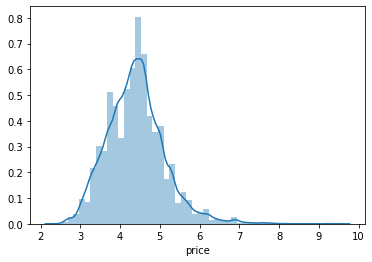

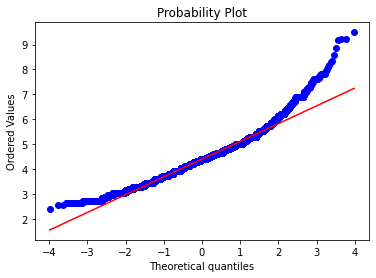

In [ ]:
sns.distplot(price_log)
fig = plt.figure()

res = scipy.stats.probplot(price_log, plot=plt)
print("Skewness: %f" %price_log.skew())
print("Kurtosis: %f" % price_log.kurt())

In [ ]:
import folium
#generate a distribution map
# https://towardsdatascience.com/data-visualization-with-python-folium-maps-a74231de9ef7
# https://towardsdatascience.com/understanding-bixi-commuters-an-analysis-of-montreals-bike-share-system-in-python-cb34de0e2304
colordict = {'Entire home/apt': 'blue', 
             'Hotel room': 'green',
             'Private room': 'orange',
             'Shared room': 'red'}

Montreal = [45.508154, -73.587450]
map = folium.Map(location = Montreal,
                 zoom_start = 11,
                 tiles = "CartoDB positron")

for lat, lon, typ, price,nbh in zip(df['latitude'], df['longitude'], df['room_type'], 
                                df['price'], df['neighbourhood']):
    folium.CircleMarker(
        [lat, lon],
        radius=.3,
        popup = ('price ' + str(price)+ '<br>'
                 'neighbourhood: ' + str(nbh) + '<br>'
                ),
        color='b',
        key_on = typ,
        threshold_scale=[0,1,2,3],
        fill_color=colordict[typ],
        fill=True,
        fill_opacity=0.7
        ).add_to(map)
      
#save map
f = "map_roomtype.html"
map.save(root_path + f)

#show map
map 

['Ahuntsic-Cartierville' 'Anjou' "Baie-d'Urfé" 'Beaconsfield'
 'Côte-Saint-Luc' 'Côte-des-Neiges-Notre-Dame-de-Grâce'
 'Dollard-des-Ormeaux' 'Dorval' 'Hampstead' 'Kirkland'
 "L'Île-Bizard-Sainte-Geneviève" 'LaSalle' 'Lachine'
 'Le Plateau-Mont-Royal' 'Le Sud-Ouest' 'Mercier-Hochelaga-Maisonneuve'
 'Mont-Royal' 'Montréal-Est' 'Montréal-Nord' 'Montréal-Ouest' 'Outremont'
 'Pierrefonds-Roxboro' 'Pointe-Claire'
 'Rivière-des-Prairies-Pointe-aux-Trembles' 'Rosemont-La Petite-Patrie'
 'Saint-Laurent' 'Saint-Léonard' 'Sainte-Anne-de-Bellevue' 'Senneville'
 'Verdun' 'Ville-Marie' 'Villeray-Saint-Michel-Parc-Extension' 'Westmount']
[ 349   75    5   33   59 1437   46   64   15   14   19  217  113 5556
 1327 1035   39    7   77   20  275   69   70   93 2059  198   84    6
    1  511 5347 1140  106]


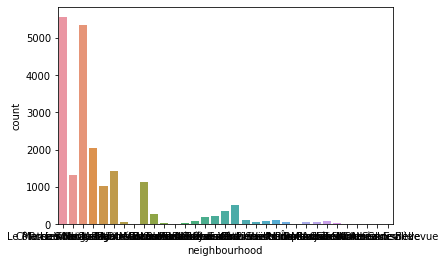

In [ ]:
#  neighbourhood
nbh_list, nbh_cnt = np.unique(df.neighbourhood, return_counts=True)
print(nbh_list)
print(nbh_cnt)
sns.countplot(x='neighbourhood',data=df)

In [ ]:
# find the coordinate centres of the neighbourhood
df[df.neighbourhood == "Anjou"].describe()
#df[df.neighbourhood == "Anjou"].describe().loc["mean","price"]


,id,host_id,neighbourhood_group,latitude,longitude,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365
count,7.500000e+01,7.500000e+01,0.0,75.000000,75.000000,75.000000,75.000000,75.000000,58.000000,75.000000,75.000000
mean,2.582634e+07,1.085682e+08,NaN,45.605189,-73.554688,63.226667,19.760000,13.360000,1.159483,2.200000,156.013333
std,1.103178e+07,9.193999e+07,NaN,0.006611,0.010711,50.276418,54.511799,23.202772,1.098647,1.874437,145.755302
min,2.208369e+06,1.255940e+05,NaN,45.592860,-73.582900,13.000000,1.000000,0.000000,0.020000,1.000000,0.000000
25%,1.941930e+07,2.430599e+07,NaN,45.599400,-73.557695,34.000000,1.000000,1.000000,0.375000,1.000000,5.000000
50%,2.681684e+07,7.198109e+07,NaN,45.606120,-73.552530,50.000000,2.000000,5.000000,0.830000,2.000000,90.000000
75%,3.570082e+07,1.903059e+08,NaN,45.609870,-73.548595,74.000000,7.000000,14.000000,1.717500,3.000000,323.500000
max,4.150272e+07,3.162331e+08,NaN,45.616730,-73.537290,325.000000,365.000000,127.000000,5.410000,10.000000,365.000000


In [ ]:
# statistic of top 10 neighbourhoods
rank = np.argsort(nbh_cnt) 
rank = rank[::-1]
top_nbh = nbh_list[rank][0:10]
print('----------- top10 neighbourhoods: -----------')
print( top_nbh)

----------- top10 neighbourhoods: -----------
['Le Plateau-Mont-Royal' 'Ville-Marie' 'Rosemont-La Petite-Patrie'
 'Côte-des-Neiges-Notre-Dame-de-Grâce' 'Le Sud-Ouest'
 'Villeray-Saint-Michel-Parc-Extension' 'Mercier-Hochelaga-Maisonneuve'
 'Verdun' 'Ahuntsic-Cartierville' 'Outremont']


In [ ]:
#creating a for loop to get statistics for price ranges and append it to our empty list
stat_top10nbh = pd.DataFrame()
for nbh in top_nbh:
    #sub data of neighbourhood
    sub =df.loc[df['neighbourhood'] == nbh]
    #describe and take the stats
    dscr = sub.describe().loc[['mean','std','min','25%','50%','75%','max'], 'price']
    stat_top10nbh[nbh] = round(dscr,2)

stat_top10nbh

,Le Plateau-Mont-Royal,Ville-Marie,Rosemont-La Petite-Patrie,Côte-des-Neiges-Notre-Dame-de-Grâce,Le Sud-Ouest,Villeray-Saint-Michel-Parc-Extension,Mercier-Hochelaga-Maisonneuve,Verdun,Ahuntsic-Cartierville,Outremont
mean,116.60,136.87,94.34,98.99,117.95,81.96,81.60,83.44,88.72,116.27
std,291.38,226.56,114.15,218.11,214.40,115.95,82.87,76.73,118.10,105.35
min,12.00,13.00,13.00,13.00,14.00,12.00,13.00,13.00,18.00,13.00
25%,50.00,60.00,48.00,40.00,50.00,40.00,40.00,44.00,44.00,55.00
50%,80.00,95.00,74.00,65.00,80.00,60.00,63.00,67.00,65.00,80.00
75%,125.00,147.00,101.00,101.00,125.00,90.00,99.00,101.00,95.00,134.00
max,13294.00,9998.00,2500.00,6969.00,5409.00,1998.00,1076.00,1200.00,1295.00,770.00


(array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9]),
 <a list of 10 Text major ticklabel objects>)

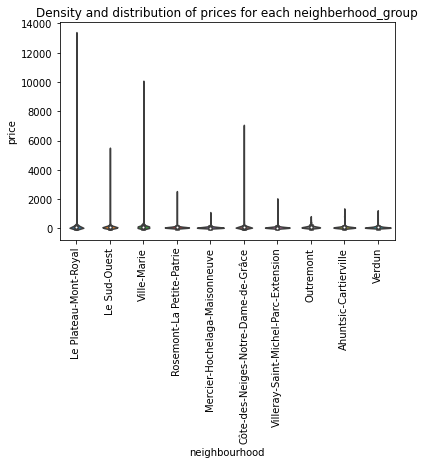

In [ ]:
#creating a sub-dataframe of top 10 neighbourhoods
df_top10nbh =df.loc[df['neighbourhood'].isin(top_nbh)]

#remove extreme values / less than 1500
# df_top10nbh = df_top10nbh[df_top10nbh.price <1500]

#using violinplot to showcase density and distribtuion of prices 
viz_2=sns.violinplot(data=df_top10nbh, x='neighbourhood', y='price')
viz_2.set_title('Density and distribution of prices for each neighberhood_group')
plt.xticks(rotation=90)

In [ ]:
max(df['price'])

13294

In [ ]:
# generate a statistic map            
Montreal = [45.508154, -73.587450]
map = folium.Map(location = Montreal,
                 zoom_start = 11,
                 tiles = "CartoDB positron")

for nbh in nbh_list:
    dscr = df[df.neighbourhood == nbh].describe()
    lat = dscr.loc["mean", "latitude"]  
    lon = dscr.loc["mean", "longitude"]
    cnt = dscr.loc["count", "id"]  
    prx_avg = dscr.loc["mean", "price"] 
    prx_std = dscr.loc["std", "price"] 
    prx_min = dscr.loc["min", "price"] 
    prx_max = dscr.loc["max", "price"] 

    folium.CircleMarker(
        [lat, lon],
        radius=2.5 * np.log1p(cnt) ,
        popup = ('price_mean ' + str(round(prx_avg))+ 'CND'+ '<br>'
                 'price_std ' + str(round(prx_std))+ 'CND'+ '<br>'
                 'neighbourhood: ' + str(nbh) + '<br>'
                ),
        color='b',
        key_on = typ,
        threshold_scale=[0,1,2,3],
        fill_color="green",
        fill=True,
        fill_opacity=0.7
        ).add_to(map)
     
#save map
f = "map_neighbourhood.html"
map.save(root_path + f)

#show map
map 

### Top hosts

[Text(0, 0, '12243051'),
 Text(0, 0, '38459934'),
 Text(0, 0, '72761895'),
 Text(0, 0, '18162251'),
 Text(0, 0, '318040'),
 Text(0, 0, '111294431'),
 Text(0, 0, '487327'),
 Text(0, 0, '387422'),
 Text(0, 0, '73995257'),
 Text(0, 0, '195649860')]

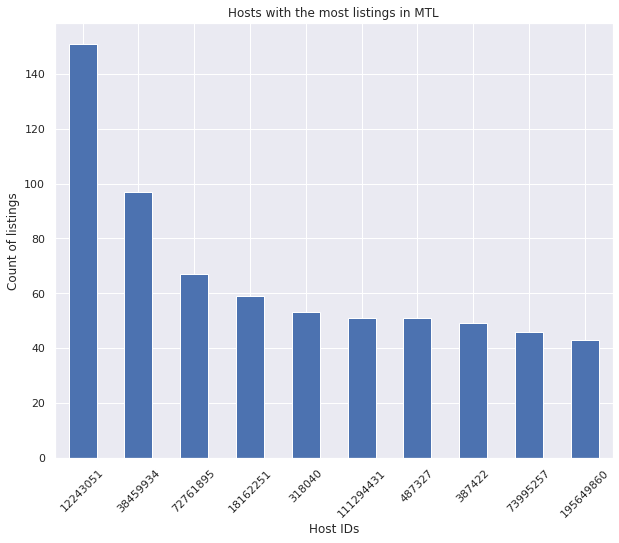

In [ ]:
# find out the top hostids
top_host=df.host_id.value_counts().head(10)
top_host

sns.set(rc={'figure.figsize':(10,8)})
viz_1=top_host.plot(kind='bar')
viz_1.set_title('Hosts with the most listings in MTL')
viz_1.set_ylabel('Count of listings')
viz_1.set_xlabel('Host IDs')
viz_1.set_xticklabels(viz_1.get_xticklabels(), rotation=45)



In [ ]:
# verify with the dataset variable
top_host_check=df.calculated_host_listings_count.max()
top_host_check

151

In [ ]:
# check the basic info of the tophost
top_host_id = top_host.index

# indexes of tophosts' listing
top_host_idx = df.host_id.isin(top_host_id)
top_host_df = df[top_host_idx]
top_host_df.head()

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
18,66247,Large Loft in Historic Old Montreal,318040,Seb,NaN,Ville-Marie,45.50475,-73.55574,Entire home/apt,110,14,264,2019-07-19,2.40,53,51
19,66249,** Chinatown & Financial District **,318040,Seb,NaN,Ville-Marie,45.51034,-73.56874,Entire home/apt,85,1,213,2019-12-30,1.94,53,301
20,66365,Perfect for Business - Parfait Pour Affaires,318040,Seb,NaN,Ville-Marie,45.50477,-73.56097,Entire home/apt,125,1,142,2019-12-11,1.30,53,307
21,66541,Cozy Apartment In The Heart Of Old Montreal,318040,Seb,NaN,Ville-Marie,45.50391,-73.55797,Entire home/apt,104,1,248,2019-12-25,2.32,53,345
26,68517,CRESCENT! BEST VIEW ! BEST LOCATION,318040,Seb,NaN,Ville-Marie,45.49838,-73.57782,Entire home/apt,99,3,175,2019-11-29,1.60,53,141


In [ ]:
colordict = {'Entire home/apt': 'blue', 
             'Hotel room': 'green',
             'Private room': 'orange',
             'Shared room': 'red'}


Montreal = [45.508154, -73.587450]
map = folium.Map(location = Montreal,
                 zoom_start = 11,
                 tiles = "CartoDB positron")

for lat, lon, typ, price,nbh, name in zip(top_host_df['latitude'], 
                                    top_host_df['longitude'], 
                                    top_host_df['room_type'], 
                                    top_host_df['price'], 
                                    top_host_df['neighbourhood'],
                                    top_host_df['host_name']):
    folium.CircleMarker(
        [lat, lon],
        radius=5,
        popup = ('host_name ' + str(name)+ '<br>'
                 'price ' + str(price)+ '<br>'
                 'neighbourhood: ' + str(nbh) + '<br>'
                ),
        color='b',
        key_on = typ,
        threshold_scale=[0,1,2,3],
        fill_color=colordict[typ],
        fill=True,
        fill_opacity=0.7
        ).add_to(map)
      
#save map
f = "top_host_df.html"
map.save(root_path + f)

#show map
map 